In [32]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import pairwise_distances
from sklearn import preprocessing as prep

# 1000Songs Example

## Attributes Explaination

- **acousticness**
A confidence measure from 0.0 to 1.0 of whether the track is acoustic. 1.0 represents high confidence the track is acoustic.	Float

- **danceability**
describes how suitable a track is for dancing based on a combination of musical elements including tempo, rhythm stability, beat strength, and overall regularity. A value of 0.0 is least danceable and 1.0 is most danceable.	Float

- **duration_ms**
The duration of the track in milliseconds.	Integer

- **energy**
is a measure from 0.0 to 1.0 and represents a perceptual measure of intensity and activity. Typically, energetic tracks feel fast, loud, and noisy. For example, death metal has high energy, while a Bach prelude scores low on the scale. Perceptual features contributing to this attribute include dynamic range, perceived loudness, timbre, onset rate, and general entropy.	Float

- **instrumentalness**
Predicts whether a track contains no vocals. “Ooh” and “aah” sounds are treated as instrumental in this context. Rap or spoken word tracks are clearly “vocal”. The closer the instrumentalness value is to 1.0, the greater likelihood the track contains no vocal content. Values above 0.5 are intended to represent instrumental tracks, but confidence is higher as the value approaches 1.0.	Float

- **key**
The key the track is in. Integers map to pitches using standard Pitch Class notation . E.g. 0 = C, 1 = C♯/D♭, 2 = D, and so on.	Integer

- **liveness**
Detects the presence of an audience in the recording. Higher liveness values represent an increased probability that the track was performed live. A value above 0.8 provides strong likelihood that the track is live.	Float

- **loudness**
The overall loudness of a track in decibels (dB). Loudness values are averaged across the entire track and are useful for comparing relative loudness of tracks. Loudness is the quality of a sound that is the primary psychological correlate of physical strength (amplitude). Values typically range between -60 and 0 db.	Float

- **mode**
Mode indicates the modality (major or minor) of a track, the type of scale from which its melodic content is derived. Major is represented by 1 and minor is 0.	Integer

- **speechiness**
detects the presence of spoken words in a track. The more exclusively speech-like the recording (e.g. talk show, audio book, poetry), the closer to 1.0 the attribute value. Values above 0.66 describe tracks that are probably made entirely of spoken words. Values between 0.33 and 0.66 describe tracks that may contain both music and speech, either in sections or layered, including such cases as rap music. Values below 0.33 most likely represent music and other non-speech-like tracks.	Float

- **tempo**
The overall estimated tempo of a track in beats per minute (BPM). In musical terminology, tempo is the speed or pace of a given piece and derives directly from the average beat duration.	Float

- **time_signature**
An estimated overall time signature of a track. The time signature (meter) is a notational convention to specify how many beats are in each bar (or measure).	Integer

- **valence**
A measure from 0.0 to 1.0 describing the musical positiveness conveyed by a track. Tracks with high valence sound more positive (e.g. happy, cheerful, euphoric), while tracks with low valence sound more negative (e.g. sad, depressed, angry).	Floa

## Import songs_df

In [33]:
songs_df = pd.read_csv("datasets\df_audio_features_1000.csv" 
                           #,index_col=["name", "artist"]
                           )
songs_df

,name,artist,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,duration_ms,time_signature,id,html
0,All Shook Up,Elvis Presley,0.6240,0.46800,10,-12.162,1,0.1320,0.881,0.000006,0.1440,0.9520,74.139,NaN,117080,4,5ueyLj6e6oVaTY0KQ6yLaA,https://open.spotify.com/track/5ueyLj6e6oVaTY0...
1,I've Got You Under My Skin - Remastered 1998,Frank Sinatra,0.5850,0.24700,1,-12.612,1,0.0400,0.452,0.000009,0.1070,0.5910,127.150,NaN,223760,4,3aEJMh1cXKEjgh52claxQp,https://open.spotify.com/track/3aEJMh1cXKEjgh5...
2,Smoke Gets In Your Eyes,The Platters,0.2900,0.22700,3,-13.060,1,0.0311,0.944,0.000079,0.6170,0.2240,114.278,NaN,157293,4,307XEC1IUwUs9ojlEFwH7f,https://open.spotify.com/track/307XEC1IUwUs9oj...
3,"What'd I Say, Pt. 1 & 2",Ray Charles,0.5400,0.68100,4,-5.440,1,0.0508,0.808,0.000000,0.1620,0.7940,88.385,NaN,307053,4,5yQ9iMZXGcr5rlO4hoLsP4,https://open.spotify.com/track/5yQ9iMZXGcr5rlO...
4,Dream A Little Dream Of Me,Ella Fitzgerald,0.4550,0.16700,0,-13.613,1,0.0739,0.918,0.000000,0.1730,0.4040,76.118,NaN,185067,4,3vFVS2WYHDG4KkWCNecvpn,https://open.spotify.com/track/3vFVS2WYHDG4KkW...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1435,"1812 Festival Overture, Op. 49: 1812 Overture,...",Pyotr Ilyich Tchaikovsky,0.2020,0.06940,3,-23.390,1,0.0473,0.917,0.715000,0.0832,0.0655,87.906,NaN,995000,4,1aEhYlZtypmipA06SDJ4U3,https://open.spotify.com/track/1aEhYlZtypmipA0...
1436,"Winter Fragments pour ensemble instrumental, s...",Tristan Murail,0.1880,0.10100,6,-21.873,1,0.0442,0.855,0.426000,0.0694,0.0355,83.134,NaN,855000,4,1Gfqe7TAKklmuZf6hxsH6h,https://open.spotify.com/track/1Gfqe7TAKklmuZf...
1437,"Schoenberg: 5 Orchestral Pieces, Op. 16: No. 3...",Arnold Schoenberg,0.0596,0.00093,9,-42.959,1,0.0434,0.951,0.969000,0.0772,0.0344,71.573,NaN,238187,3,2XNwnFrdMDpismp0VUZ7cU,https://open.spotify.com/track/2XNwnFrdMDpismp...
1438,"Serenade For Strings In E, Op.22, B. 52: 1. Mo...",Antonín Dvořák,0.1330,0.02080,4,-29.443,1,0.0419,0.883,0.505000,0.1110,0.0591,67.109,NaN,314307,4,7ucDwgMtE3YJtEfTbuRhy0,https://open.spotify.com/track/7ucDwgMtE3YJtEf...


In [34]:
#1. drop feature with string type / and all Null column
songs_df = songs_df.drop(["name","artist","id","html","type"],axis=1)

### Use all features

In [35]:
songs_df.describe()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
count,1440.000000,1440.000000,1440.000000,1440.000000,1440.000000,1440.000000,1440.000000,1440.000000,1440.000000,1440.000000,1440.000000,1.440000e+03,1440.000000
mean,0.538917,0.494241,5.154861,-11.098032,0.663194,0.086273,0.469774,0.188482,0.174391,0.472576,115.249066,2.912083e+05,3.889583
std,0.219193,0.281917,3.540932,6.979107,0.472782,0.086193,0.374637,0.336594,0.146007,0.287807,31.611805,2.280920e+05,0.446937
min,0.059600,0.000020,0.000000,-44.406000,0.000000,0.023200,0.000002,0.000000,0.020700,0.019600,49.689000,6.275800e+04,1.000000
25%,0.386000,0.243000,2.000000,-14.927250,0.000000,0.038400,0.083025,0.000000,0.090700,0.214750,91.014250,1.930300e+05,4.000000
50%,0.562000,0.529500,5.000000,-8.939500,1.000000,0.048200,0.419000,0.000127,0.118000,0.476500,110.008000,2.336965e+05,4.000000
75%,0.710250,0.733000,8.000000,-5.677250,1.000000,0.088825,0.869250,0.159750,0.203000,0.720000,135.587000,3.080625e+05,4.000000
max,0.964000,0.996000,11.000000,1.085000,1.000000,0.576000,0.996000,0.985000,0.985000,0.985000,206.313000,3.815787e+06,5.000000


### Use selected features
Keep the following

- **energy**
is a measure from 0.0 to 1.0 and represents a perceptual measure of intensity and activity. Typically, energetic tracks feel fast, loud, and noisy. For example, death metal has high energy, while a Bach prelude scores low on the scale. Perceptual features contributing to this attribute include dynamic range, perceived loudness, timbre, onset rate, and general entropy.	Float

- **speechiness**
detects the presence of spoken words in a track. The more exclusively speech-like the recording (e.g. talk show, audio book, poetry), the closer to 1.0 the attribute value. Values above 0.66 describe tracks that are probably made entirely of spoken words. Values between 0.33 and 0.66 describe tracks that may contain both music and speech, either in sections or layered, including such cases as rap music. Values below 0.33 most likely represent music and other non-speech-like tracks.	Float

- **acousticness**
A confidence measure from 0.0 to 1.0 of whether the track is acoustic. 1.0 represents high confidence the track is acoustic.	Float


- **tempo**
The overall estimated tempo of a track in beats per minute (BPM). In musical terminology, tempo is the speed or pace of a given piece and derives directly from the average beat duration.	Float


In [36]:
songs_df=songs_df.drop(["danceability","key","mode","loudness","instrumentalness","liveness","valence","duration_ms","time_signature"],axis=1)

In [37]:
songs_df.describe()

,energy,speechiness,acousticness,tempo
count,1440.000000,1440.000000,1440.000000,1440.000000
mean,0.494241,0.086273,0.469774,115.249066
std,0.281917,0.086193,0.374637,31.611805
min,0.000020,0.023200,0.000002,49.689000
25%,0.243000,0.038400,0.083025,91.014250
50%,0.529500,0.048200,0.419000,110.008000
75%,0.733000,0.088825,0.869250,135.587000
max,0.996000,0.576000,0.996000,206.313000


##  Compare heatmap with and without tempo column

In [38]:
#prepare edist_df for no_age_food columns
no_tempo_songs_df = songs_df.drop("tempo",axis=1).copy()
no_tempo_songs_edis_df = pd.DataFrame(
    pairwise_distances(no_tempo_songs_df,metric="euclidean")
    ,index=no_tempo_songs_df.index
    ,columns=no_tempo_songs_df.index
    )

In [39]:
#prepare edist_df for food columns
songs_edis_df = pd.DataFrame(
    pairwise_distances(songs_df,metric="euclidean")
    ,index=songs_df.index
    ,columns=songs_df.index
    )

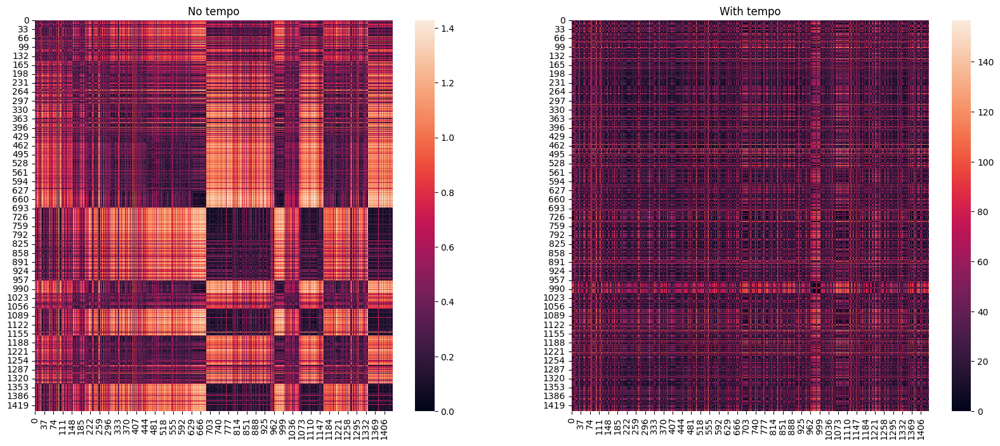

In [40]:
# plot both edist together
fig,(ax1,ax2) = plt.subplots(1,2,figsize = (20,8))
sns.heatmap(no_tempo_songs_edis_df,ax=ax1)
sns.heatmap(songs_edis_df,ax=ax2)
ax1.set_title("No tempo")
ax2.set_title("With tempo")
plt.show()
#clear that the age column covered all data in other columns

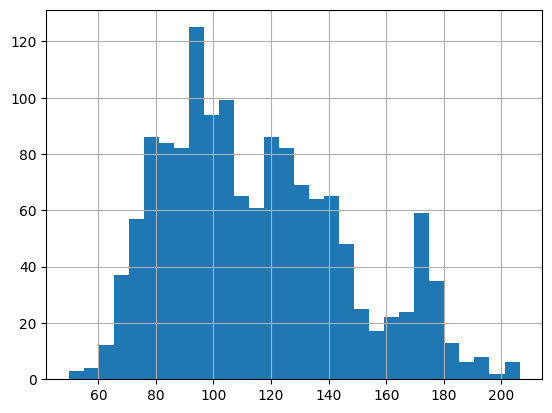

In [41]:
songs_df.tempo.hist(bins=30);

## Use Scalers
Scalers do not change the distribution of the data, they change the range of the data

### MinMax Scaler
All columns get scaled between min and max (default 0 and 1)
MinMaxScaler subtracts the minimum value in the feature and then divides by the range. 
The range is the difference between the original maximum and original minimum.

MinMaxScaler **preserves the shape of the original distribution**. 
It doesn’t meaningfully change the information embedded in the original data.

MinMaxScaler **doesn’t reduce the importance of outliers**.

$newValue = \frac{oldValue - min(column)}{max(column) - min(column)}$

> **when to use**
MinMaxScaler isn’t a bad place to start unless:
>- you know you want your feature to have a normal distribution.
>- or you have outliers and you want them to have reduced influence.


#### Use Scaler

In [42]:
# init the transformer instance , define min/max values , type of output.
minmax_scaler = prep.MinMaxScaler(feature_range=(0,1)).set_output(transform='pandas')

In [43]:
# the scaler learn about the df and store some data for each feature
minmax_scaler.fit(songs_df)
pd.DataFrame(
    {
        "features":minmax_scaler.feature_names_in_,
        "scale":minmax_scaler.scale_,  # = 1/data_range_
        "minAdjust":minmax_scaler.min_,  # = min - X.min(axis=0) * scale_
        "data min":minmax_scaler.data_min_,
        "data max":minmax_scaler.data_max_,
        "data range":minmax_scaler.data_range_
    }
)

,features,scale,minAdjust,data min,data max,data range
0,energy,1.004037,-0.000020,0.000020,0.996,0.995980
1,speechiness,1.808973,-0.041968,0.023200,0.576,0.552800
2,acousticness,1.004018,-0.000002,0.000002,0.996,0.995998
3,tempo,0.006385,-0.317250,49.689000,206.313,156.624000


In [46]:
round(songs_df.describe(),3)

,energy,speechiness,acousticness,tempo
count,1440.000,1440.000,1440.000,1440.000
mean,0.494,0.086,0.470,115.249
std,0.282,0.086,0.375,31.612
min,0.000,0.023,0.000,49.689
25%,0.243,0.038,0.083,91.014
50%,0.530,0.048,0.419,110.008
75%,0.733,0.089,0.869,135.587
max,0.996,0.576,0.996,206.313


In [47]:
# Use the fitted transformer to actually transform the data.
songs_minmax_df = minmax_scaler.transform(songs_df)

#### Compare scaled with unscaled features

##### Compare values

In [51]:
#display the features feature before and after the transformation
round(pd.DataFrame(
    {
        "orig_tempo":songs_df.loc[:,"tempo"],
        "minmax_scaled_tempo":songs_minmax_df.loc[:,"tempo"],
        "orig_energy":songs_df.loc[:,"energy"],
        "minmax_scaled_energy":songs_minmax_df.loc[:,"energy"]
    }
).describe(),3)

,orig_tempo,minmax_scaled_tempo,orig_energy,minmax_scaled_energy
count,1440.000,1440.000,1440.000,1440.000
mean,115.249,0.419,0.494,0.496
std,31.612,0.202,0.282,0.283
min,49.689,0.000,0.000,0.000
25%,91.014,0.264,0.243,0.244
50%,110.008,0.385,0.530,0.532
75%,135.587,0.548,0.733,0.736
max,206.313,1.000,0.996,1.000


In [52]:
round(songs_minmax_df,3)

,energy,speechiness,acousticness,tempo
0,0.470,0.197,0.885,0.156
1,0.248,0.030,0.454,0.495
2,0.228,0.014,0.948,0.412
3,0.684,0.050,0.811,0.247
4,0.168,0.092,0.922,0.169
...,...,...,...,...
1435,0.070,0.044,0.921,0.244
1436,0.101,0.038,0.858,0.214
1437,0.001,0.037,0.955,0.140
1438,0.021,0.034,0.887,0.111


##### Compare distribution (Hist)

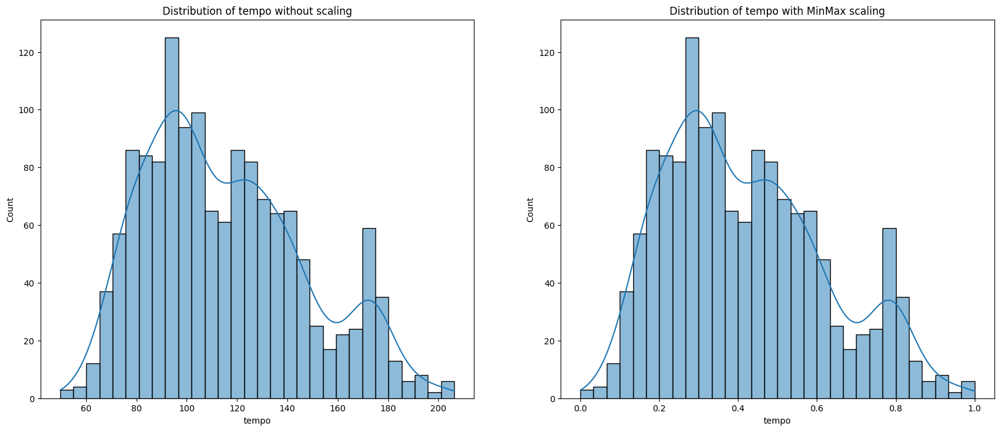

In [54]:
fig,(ax1,ax2)= plt.subplots(1,2,figsize=(20,8))
sns.histplot(data=songs_df.loc[:,"tempo"],bins=30,kde=True,ax=ax1)
sns.histplot(data=songs_minmax_df.loc[:,"tempo"],bins=30,kde=True,ax=ax2)

ax1.set_title("Distribution of tempo without scaling")
ax2.set_title("Distribution of tempo with MinMax scaling")
plt.show()

##### Compare Heatmap

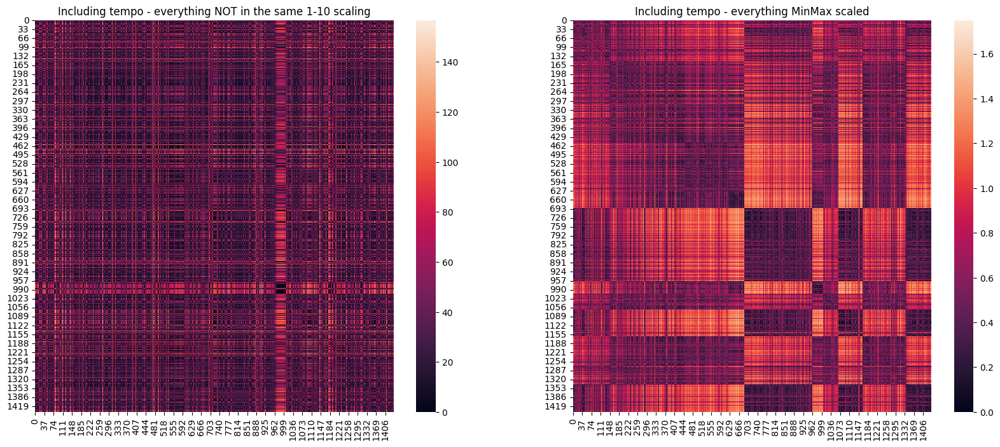

In [56]:
songs_minmax_edis_df = pd.DataFrame(pairwise_distances(songs_minmax_df),index=songs_minmax_df.index,columns=songs_minmax_df.index)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))
sns.heatmap(songs_edis_df, ax=ax1);
sns.heatmap(songs_minmax_edis_df, ax=ax2);
ax1.set_title('Including tempo - Original')
ax2.set_title('Including tempo - everything MinMax scaled')

plt.show()

# By ensuring that all of the columns are scaled between 0 and 1, 
# we prevent any column with a much larger scale having a much larger affect on our final output.

### Standard scaler
All of the columns get scaled according to the standard deviation of the column. 
The standard deviation equals one, and all other values get scaled accordingly. 
Additionally the data gets centered around 0 as the mean. 
This means that the mean becomes 0, all values less than the mean will be negative, and all values higher than the mean will be positive.

$newValue = \frac{oldValue - mean(column)}{std(column)}$

StandardScaler is the industry’s go-to algorithm.
StandardScaler does not meet the strict definition of scale

> **when to use**
> - Deep learning algorithms often call for zero mean and unit variance. 
> - Regression-type algorithms also benefit from normally distributed data with small sample sizes.
> - can specify outliers easier as can shown from the hsitogram >1STD


#### Use Scaler

In [57]:
# init the transformer instance , define type of output.
std_scaler = prep.StandardScaler(
    #with_mean=False
    #,
    #with_std=False
    ).set_output(transform='pandas')

In [67]:
# the scaler learn about the df and store some of the features
import math
import numpy as np
std_scaler.fit(songs_df)
pd.DataFrame(
    {
        "features":std_scaler.feature_names_in_,
        "scale":std_scaler.scale_,  # std per feature
        "mean":std_scaler.mean_,
        "variance":std_scaler.var_,
        "std": np.sqrt(std_scaler.var_)  # std calculated from the variance
    }
)

,features,scale,mean,variance,std
0,energy,0.281819,0.494241,0.079422,0.281819
1,speechiness,0.086163,0.086273,0.007424,0.086163
2,acousticness,0.374507,0.469774,0.140255,0.374507
3,tempo,31.600827,115.249066,998.612264,31.600827


In [68]:
songs_df.describe()

,energy,speechiness,acousticness,tempo
count,1440.000000,1440.000000,1440.000000,1440.000000
mean,0.494241,0.086273,0.469774,115.249066
std,0.281917,0.086193,0.374637,31.611805
min,0.000020,0.023200,0.000002,49.689000
25%,0.243000,0.038400,0.083025,91.014250
50%,0.529500,0.048200,0.419000,110.008000
75%,0.733000,0.088825,0.869250,135.587000
max,0.996000,0.576000,0.996000,206.313000


In [64]:
# Use the fitted transformer to actually transform the data.
songs_std_df = std_scaler.transform(songs_df)

#### Compare scaled with unscaled features

##### Compare values

In [66]:
#display the features feature before and after the transformation
round(pd.DataFrame(
    {
        "orig_tempo":songs_df.loc[:,"tempo"],
        "std_scaled_tempo":songs_std_df.loc[:,"tempo"],
        "orig_energy":songs_df.loc[:,"energy"],
        "std_scaled_energy":songs_std_df.loc[:,"energy"]
    }
).describe(),3)

,orig_tempo,std_scaled_tempo,orig_energy,std_scaled_energy
count,1440.000,1440.000,1440.000,1440.000
mean,115.249,-0.000,0.494,-0.000
std,31.612,1.000,0.282,1.000
min,49.689,-2.075,0.000,-1.754
25%,91.014,-0.767,0.243,-0.891
50%,110.008,-0.166,0.530,0.125
75%,135.587,0.644,0.733,0.847
max,206.313,2.882,0.996,1.780


In [69]:
round(songs_std_df,3)

,energy,speechiness,acousticness,tempo
0,-0.093,0.531,1.098,-1.301
1,-0.877,-0.537,-0.047,0.377
2,-0.948,-0.640,1.266,-0.031
3,0.663,-0.412,0.903,-0.850
4,-1.161,-0.144,1.197,-1.238
...,...,...,...,...
1435,-1.507,-0.452,1.194,-0.865
1436,-1.395,-0.488,1.029,-1.016
1437,-1.750,-0.498,1.285,-1.382
1438,-1.680,-0.515,1.103,-1.523


##### Compare distribution (Hist)

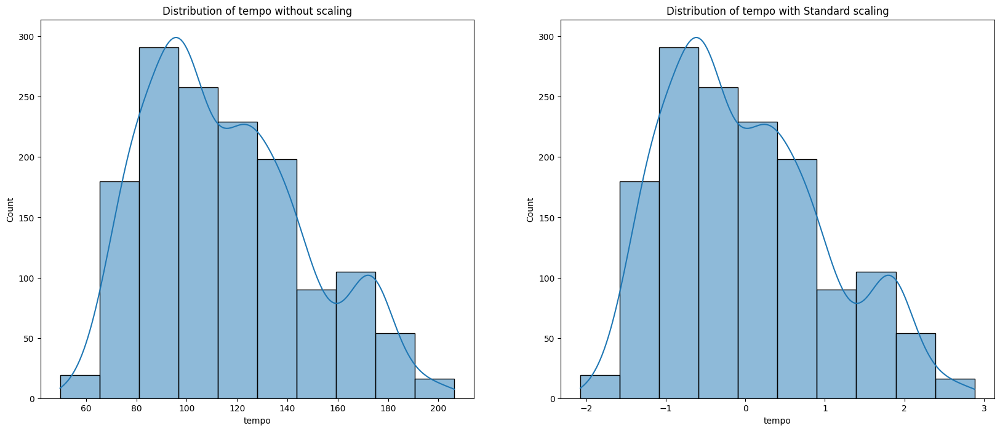

In [71]:
fig,(ax1,ax2)= plt.subplots(1,2,figsize=(20,8))
sns.histplot(data=songs_df.loc[:,"tempo"],bins=10,kde=True,ax=ax1)
sns.histplot(data=songs_std_df.loc[:,"tempo"],bins=10,kde=True,ax=ax2)

ax1.set_title("Distribution of tempo without scaling")
ax2.set_title("Distribution of tempo with Standard scaling")
plt.show()

# Its nice to spot the outliers ( > 2 std) ie x>1  , in this case its Hana age

##### Compare heatmap

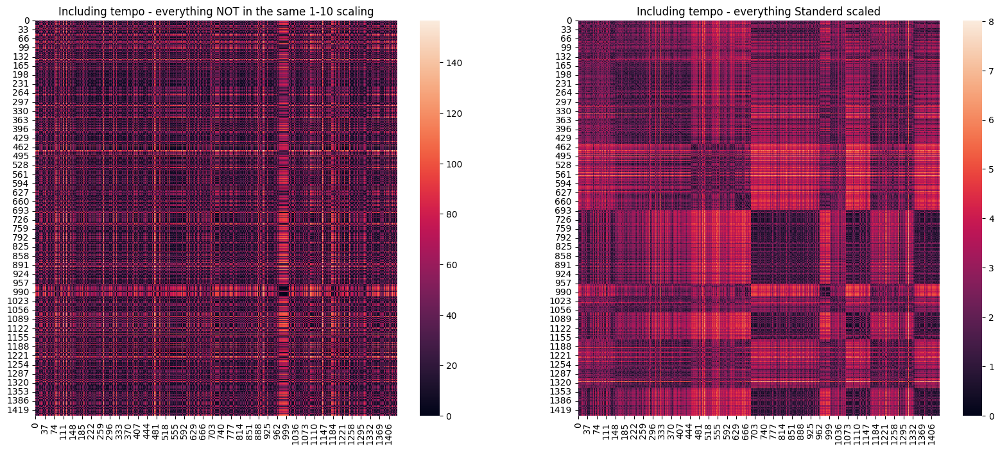

In [72]:
songs_std_edis_df = pd.DataFrame(pairwise_distances(songs_std_df),index=songs_std_df.index,columns=songs_std_df.index)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))
sns.heatmap(songs_edis_df, ax=ax1);
sns.heatmap(songs_std_edis_df, ax=ax2);
ax1.set_title('Including tempo - everything NOT in the same 1-10 scaling')
ax2.set_title('Including tempo - everything Standerd scaled')

plt.show()

# By ensuring that all of the columns are scaled , 
# we prevent any column with a much larger scale having a much larger affect on our final output.

### Robust scaler
All of the columns get scaled between their interquartile ranges. 
The lowest value of the column equals the first quartile(25%), 
the highest value of the column equals the third quartile(75%), 
and all other values get scaled in between.
In addition to this the data gets centered around 0 as the median.

This means that the median becomes 0 and, therefore,
all values less than the median will be negative, 
and all values higher than the median will be positive.

$ newValue = \frac{oldValue - median(column)}{IQR(column)}$


RobustScaler does not scale the data into a predetermined interval like MinMaxScaler. It does not meet the strict definition of scale
> **when to use**
>   if you want to reduce the effects of outliers, relative to MinMaxScaler.

#### Use Scaler

In [73]:
# init the transformer instance , define type of output.
robust_scaler = prep.RobustScaler(
                                #   with_centering=True
                                #   , with_scaling=True
                                #   , quantile_range=(25.0, 75.0)
                                #   , copy=True
                                #   , unit_variance=False
                                  ).set_output(transform='pandas')

In [74]:
# the scaler learn about the df and store some value of each feature
robust_scaler.fit(songs_df)
pd.DataFrame(
    {
        "features":robust_scaler.feature_names_in_,
        "scale":robust_scaler.scale_, #The (scaled) interquartile range for each feature
        "center":robust_scaler.center_  #The median value for each feature
    }
)

,features,scale,center
0,energy,0.490000,0.5295
1,speechiness,0.050425,0.0482
2,acousticness,0.786225,0.4190
3,tempo,44.572750,110.0080


In [75]:
# Use the fitted transformer to actually transform the data.
songs_robust_df = robust_scaler.transform(songs_df)

#### Compare scaled with unscaled features

##### Compare values

In [76]:
#display the features feature before and after the transformation
round(pd.DataFrame(
    {
        "orig_tempo":songs_df.loc[:,"tempo"],
        "robust_scaled_tempo":songs_robust_df.loc[:,"tempo"],
        "orig_energy":songs_df.loc[:,"energy"],
        "robust_scaled_energy":songs_robust_df.loc[:,"energy"]
    }
).sort_values(by="orig_tempo"),3)

,orig_tempo,robust_scaled_tempo,orig_energy,robust_scaled_energy
907,49.689,-1.353,0.053,-0.973
908,51.059,-1.323,0.028,-1.024
896,52.789,-1.284,0.055,-0.968
941,57.312,-1.182,0.110,-0.856
1421,58.339,-1.159,0.207,-0.658
...,...,...,...,...
457,201.936,2.062,0.931,0.819
1142,202.983,2.086,0.222,-0.628
271,203.206,2.091,0.824,0.601
110,205.973,2.153,0.678,0.303


In [77]:
round(songs_robust_df,3)

,energy,speechiness,acousticness,tempo
0,-0.126,1.662,0.588,-0.805
1,-0.577,-0.163,0.042,0.385
2,-0.617,-0.339,0.668,0.096
3,0.309,0.052,0.495,-0.485
4,-0.740,0.510,0.635,-0.760
...,...,...,...,...
1435,-0.939,-0.018,0.633,-0.496
1436,-0.874,-0.079,0.555,-0.603
1437,-1.079,-0.095,0.677,-0.862
1438,-1.038,-0.125,0.590,-0.962


##### Compare distribution (Hist)

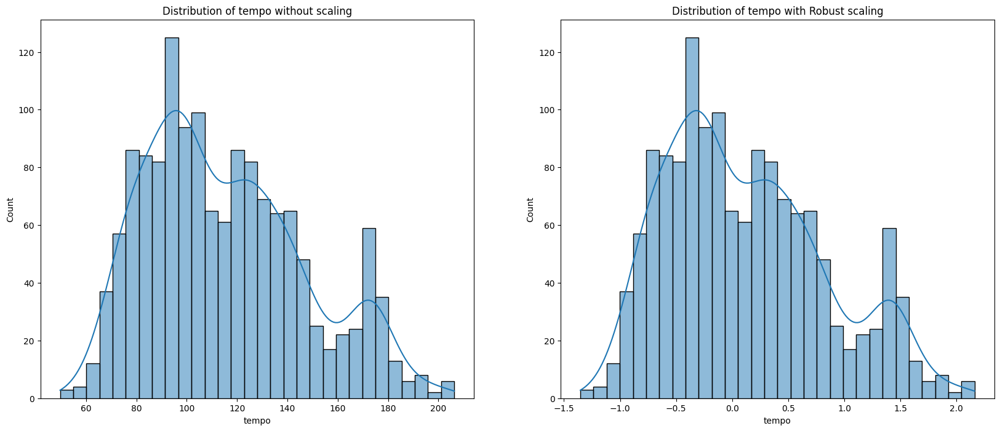

In [79]:
fig,(ax1,ax2)= plt.subplots(1,2,figsize=(20,8))
sns.histplot(data=songs_df.loc[:,"tempo"],bins=30,kde=True,ax=ax1)
sns.histplot(data=songs_robust_df.loc[:,"tempo"],bins=30,kde=True,ax=ax2)

ax1.set_title("Distribution of tempo without scaling")
ax2.set_title("Distribution of tempo with Robust scaling")
plt.show()

##### Compare heatmap

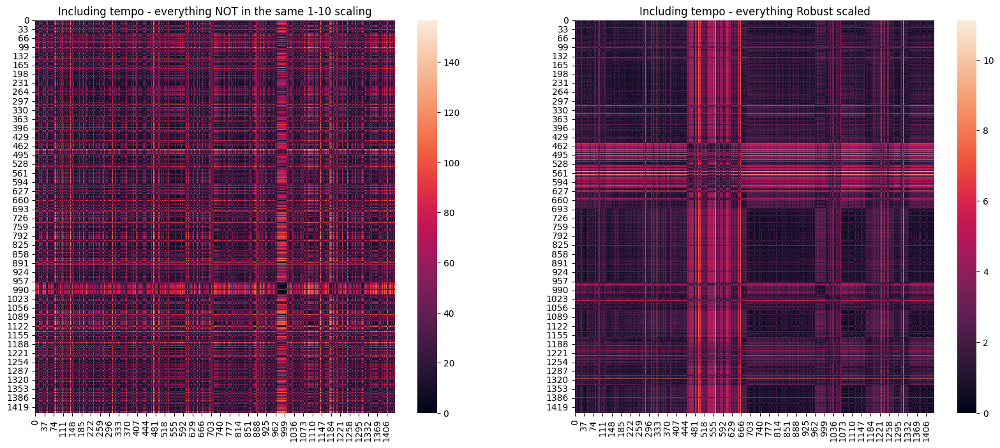

In [80]:
songs_robust_edis_df = pd.DataFrame(pairwise_distances(songs_robust_df),index=songs_robust_df.index,columns=songs_robust_df.index)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))
sns.heatmap(songs_edis_df, ax=ax1);
sns.heatmap(songs_robust_edis_df, ax=ax2);
ax1.set_title('Including tempo - everything NOT in the same 1-10 scaling')
ax2.set_title('Including tempo - everything Robust scaled')

plt.show()

# The robust scaler can often be a good idea, 
# it's designed to help against outliers affecting the data by using the interquartile range
# instead of the full range (like the minmax scaler). 
# Unfortunately, here it hasn't helped much 
# because the interquartile range of the age column is so much larger 
# than the interquartile range of any other column, 
# and therefore the age column still distorts our concept of similarity (distance).

## Use Transformers

Transformers change the distribution to more closely resemble a normal distribution. Data that conforms to the normal distribution in machine learning is advantageous for model construction since it simplifies the maths. The assumption that the distribution is normal is explicitly used in the calculations for models like LDA, Gaussian Naive Bayes, Logistic Regression, Linear Regression, etc.

### Quantile Transformer
All of the columns get scaled according to their [quantile](https://en.wikipedia.org/wiki/Quantile).

> **Note:** Quantiles are divisions of the data, which tell us how much of the data is present below this point. For example, the median is the middle of the data, this is therefore a quantile of 0.5, half of the data exists at or below this point. By the same measure, 78% of the data exists at or below the quantile 0.78.

#### Use Transformer

In [81]:
# init the transformer instance , define type of output.
quantile_trans = prep.QuantileTransformer(
  #TODO: isn't easier to set num of sample (n_quantiles) to df.shape[0]?
                n_quantiles=songs_df.shape[0]
                # , output_distribution='uniform'
                # , ignore_implicit_zeros=False
                # , subsample=10000
                # , random_state=None
                # , copy=True
                ).set_output(transform='pandas')

  

In [83]:
# the scaler learn about the df and store some value of each feature
quantile_trans.fit(songs_df)
#TODO: anyone could access the attribues of the trans?
# pd.DataFrame(
# quantile_trans.quantiles_,columns=quantile_trans.feature_names_in_
# )

QuantileTransformer(n_quantiles=1440)

In [85]:
# Use the fitted transformer to actually transform the data.
songs_quant_trans_df = quantile_trans.transform(songs_df)

#### Compare scaled with unscaled features

##### Compare values

In [86]:
#display the features feature before and after the transformation
round(pd.DataFrame(
    {
        "orig_tempo":songs_df.loc[:,"tempo"],
        "minmax_scaled_tempo":songs_quant_trans_df.loc[:,"tempo"],
        "orig_energy":songs_df.loc[:,"energy"],
        "minmax_scaled_energy":songs_quant_trans_df.loc[:,"energy"]
    }
).describe(),3)

,orig_tempo,minmax_scaled_tempo,orig_energy,minmax_scaled_energy
count,1440.000,1440.000,1440.000,1440.000
mean,115.249,0.500,0.494,0.500
std,31.612,0.289,0.282,0.289
min,49.689,0.000,0.000,0.000
25%,91.014,0.250,0.243,0.250
50%,110.008,0.500,0.530,0.500
75%,135.587,0.750,0.733,0.749
max,206.313,1.000,0.996,1.000


In [87]:
round(songs_quant_trans_df,3)

,energy,speechiness,acousticness,tempo
0,0.443,0.830,0.764,0.066
1,0.254,0.302,0.513,0.673
2,0.235,0.075,0.858,0.538
3,0.681,0.537,0.693,0.218
4,0.185,0.701,0.808,0.083
...,...,...,...,...
1435,0.076,0.486,0.806,0.213
1436,0.117,0.428,0.732,0.162
1437,0.001,0.405,0.872,0.044
1438,0.022,0.353,0.767,0.023


##### Compare distribution (Hist)

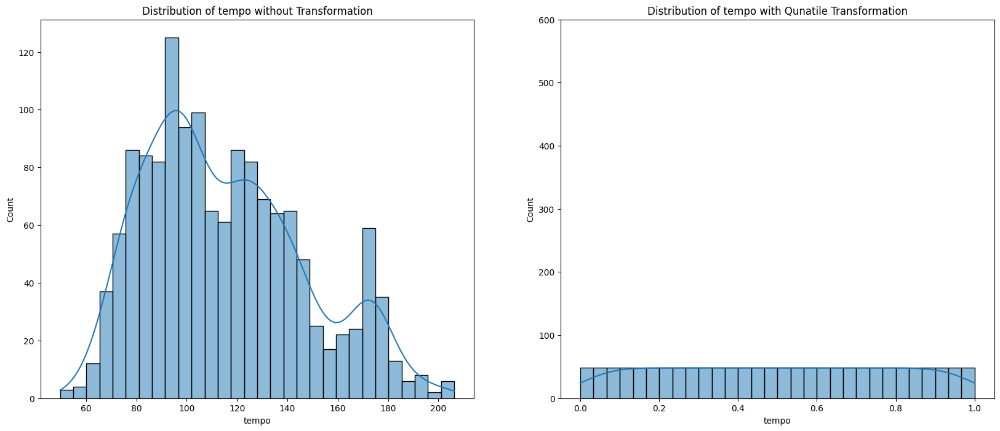

In [93]:
fig,(ax1,ax2)= plt.subplots(1,2,figsize=(20,8))
sns.histplot(data=songs_df.loc[:,"tempo"],bins=30,kde=True,ax=ax1)
sns.histplot(data=songs_quant_trans_df.loc[:,"tempo"],bins=30,kde=True,ax=ax2)
ax2.set_ylim(0,600)
ax1.set_title("Distribution of tempo without Transformation")
ax2.set_title("Distribution of tempo with Qunatile Transformation")
plt.show()

##### Compare heatmap

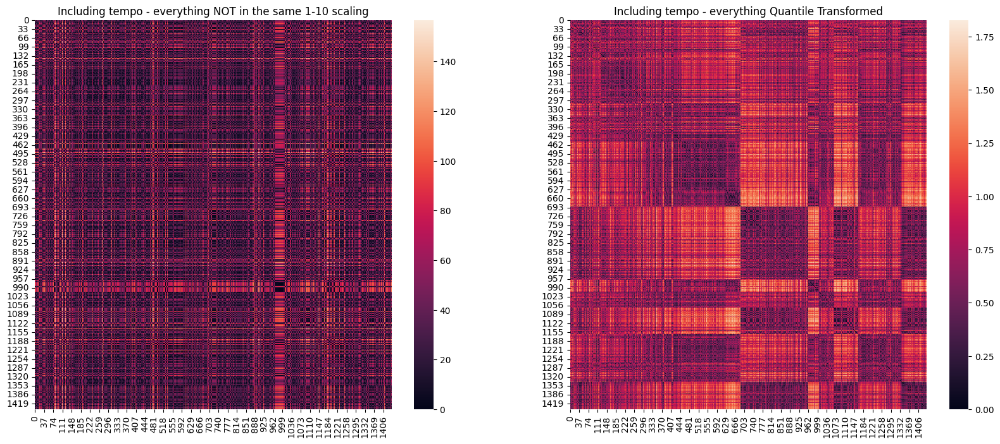

In [95]:
songs_quant_trans_edis_df = pd.DataFrame(pairwise_distances(songs_quant_trans_df),index=songs_quant_trans_df.index,columns=songs_quant_trans_df.index)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))
sns.heatmap(songs_edis_df, ax=ax1);
sns.heatmap(songs_quant_trans_edis_df, ax=ax2);
ax1.set_title('Including tempo - everything NOT in the same 1-10 scaling')
ax2.set_title('Including tempo - everything Quantile Transformed')

plt.show()

### Power Transformer
Power transformers transform the data via [power functions](https://en.wikipedia.org/wiki/Power_transform). They can use either the Yeo-Johnson transformation, or the Box-Cox transformation. You don't need to understand the maths behind this one, just know that it reshapes the data to more closely resemble the normal distribution.

#### Use Transformer

In [96]:
# init the transformer instance , define type of output.
power_trans = prep.PowerTransformer(
                        # method='yeo-johnson'
                        # , standardize=True  #Set to True to apply zero-mean, unit-variance normalization to the transformed output.
                        # , copy=True
                      ).set_output(transform='pandas')

  

In [97]:
# the Transformer learn about the df and store some value of each feature
power_trans.fit(songs_df)
pd.DataFrame(
    {
        "features":power_trans.feature_names_in_,
        "lambdas":power_trans.lambdas_
    }
)

,features,lambdas
0,energy,1.169512
1,speechiness,-16.858742
2,acousticness,0.161840
3,tempo,-0.052395


In [98]:
# Use the fitted transformer to actually transform the data.
songs_power_trans_df = power_trans.transform(songs_df)

#### Compare scaled with unscaled features

##### Compare values

In [99]:
#display the features feature before and after the transformation
round(pd.DataFrame(
    {
        "orig_tempo":songs_df.loc[:,"tempo"],
        "minmax_scaled_tempo":songs_power_trans_df.loc[:,"tempo"],
        "orig_energy":songs_df.loc[:,"energy"],
        "minmax_scaled_energy":songs_power_trans_df.loc[:,"energy"]
    }
).describe(),3)

,orig_tempo,minmax_scaled_tempo,orig_energy,minmax_scaled_energy
count,1440.000,1440.000,1440.000,1440.000
mean,115.249,0.000,0.494,-0.000
std,31.612,1.000,0.282,1.000
min,49.689,-2.995,0.000,-1.722
25%,91.014,-0.728,0.243,-0.898
50%,110.008,-0.029,0.530,0.110
75%,135.587,0.735,0.733,0.845
max,206.313,2.249,0.996,1.817


In [100]:
round(songs_power_trans_df,3)

,energy,speechiness,acousticness,tempo
0,-0.110,1.321,1.081,-1.490
1,-0.884,-0.697,0.061,0.501
2,-0.953,-1.111,1.214,0.111
3,0.656,-0.273,0.922,-0.837
4,-1.159,0.411,1.159,-1.392
...,...,...,...,...
1435,-1.489,-0.402,1.157,-0.857
1436,-1.383,-0.523,1.025,-1.064
1437,-1.719,-0.555,1.228,-1.622
1438,-1.652,-0.617,1.085,-1.863


##### Compare distribution (Hist)

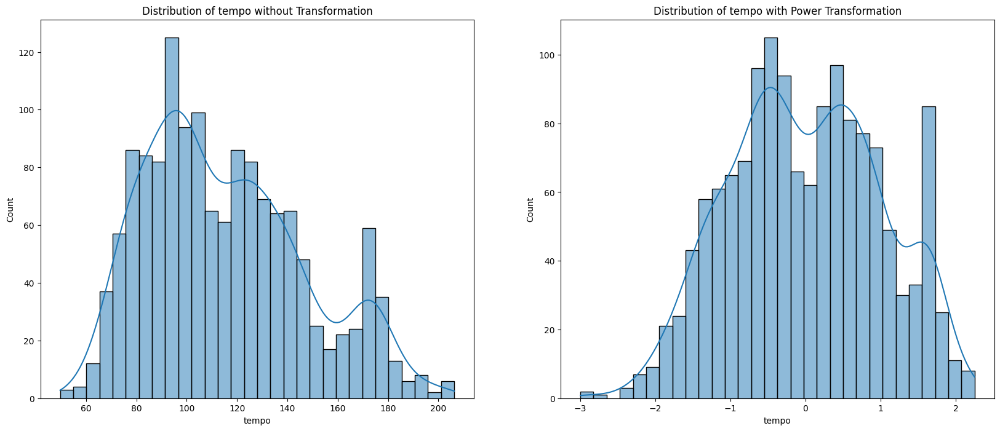

In [101]:
fig,(ax1,ax2)= plt.subplots(1,2,figsize=(20,8))
sns.histplot(data=songs_df.loc[:,"tempo"],bins=30,kde=True,ax=ax1)
sns.histplot(data=songs_power_trans_df.loc[:,"tempo"],bins=30,kde=True,ax=ax2)

ax1.set_title("Distribution of tempo without Transformation")
ax2.set_title("Distribution of tempo with Power Transformation")
plt.show()

##### Compare heatmap

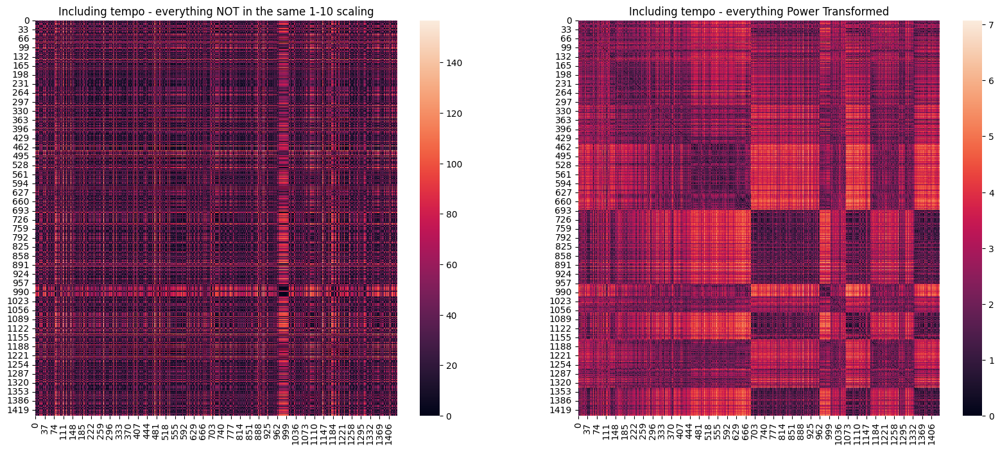

In [102]:
songs_power_trans_edis_df = pd.DataFrame(pairwise_distances(songs_power_trans_df),index=songs_power_trans_df.index,columns=songs_power_trans_df.index)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))
sns.heatmap(songs_edis_df, ax=ax1);
sns.heatmap(songs_power_trans_edis_df, ax=ax2);
ax1.set_title('Including tempo - everything NOT in the same 1-10 scaling')
ax2.set_title('Including tempo - everything Power Transformed')

plt.show()

## Compare all Together

### All histograms

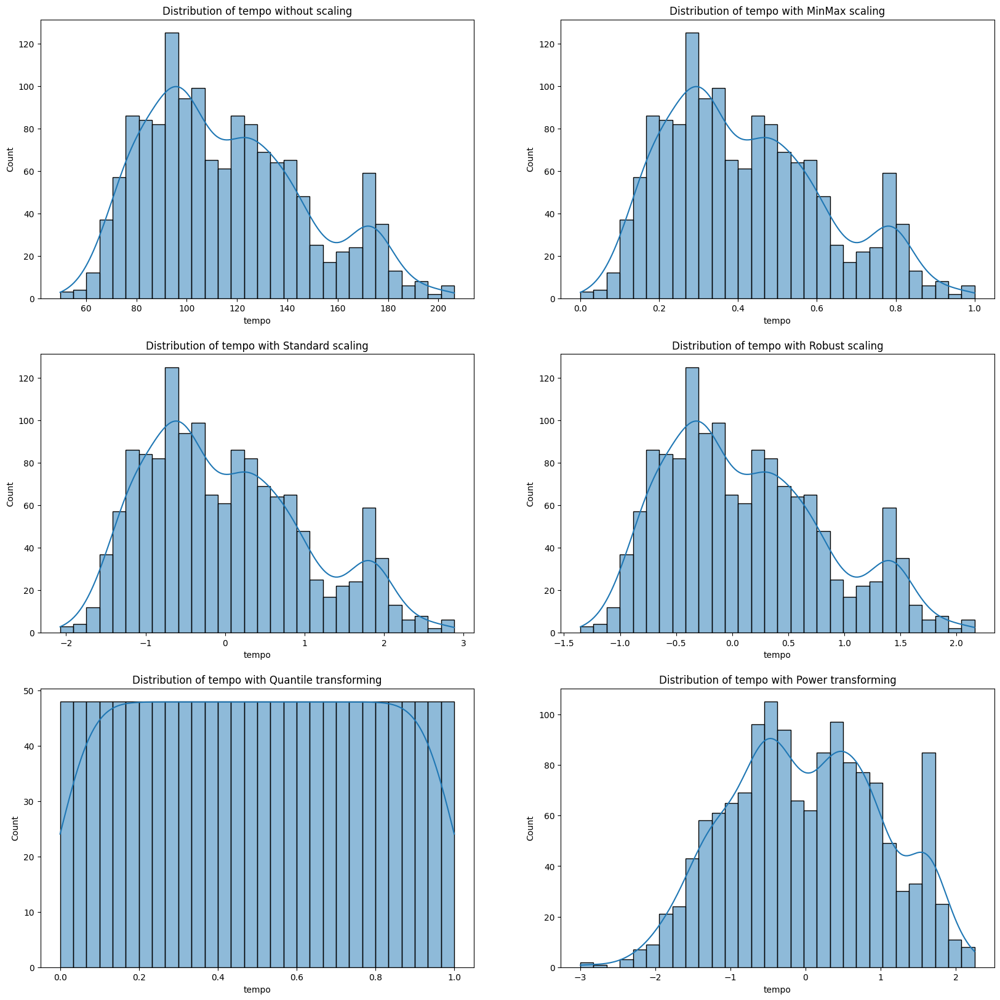

In [103]:
fig, ax = plt.subplots(3, 2, figsize=(20, 20))

sns.histplot(data=songs_df.iloc[:,-1], bins=30, kde=True, ax=ax[0, 0]);
sns.histplot(data=songs_minmax_df.iloc[:,-1], bins=30, kde=True, ax=ax[0, 1]);

sns.histplot(data=songs_std_df.iloc[:,-1], bins=30, kde=True, ax=ax[1, 0]);
sns.histplot(data=songs_robust_df.iloc[:,-1], bins=30, kde=True, ax=ax[1, 1]);

sns.histplot(data=songs_quant_trans_df.iloc[:,-1], bins=30, kde=True, ax=ax[2, 0]);
sns.histplot(data=songs_power_trans_df.iloc[:,-1], bins=30, kde=True, ax=ax[2, 1]);

ax[0, 0].set_title('Distribution of tempo without scaling')
ax[0, 1].set_title('Distribution of tempo with MinMax scaling')
ax[1, 0].set_title('Distribution of tempo with Standard scaling')
ax[1, 1].set_title('Distribution of tempo with Robust scaling')
ax[2, 0].set_title('Distribution of tempo with Quantile transforming')
ax[2, 1].set_title('Distribution of tempo with Power transforming')

plt.show()

### All heatmaps

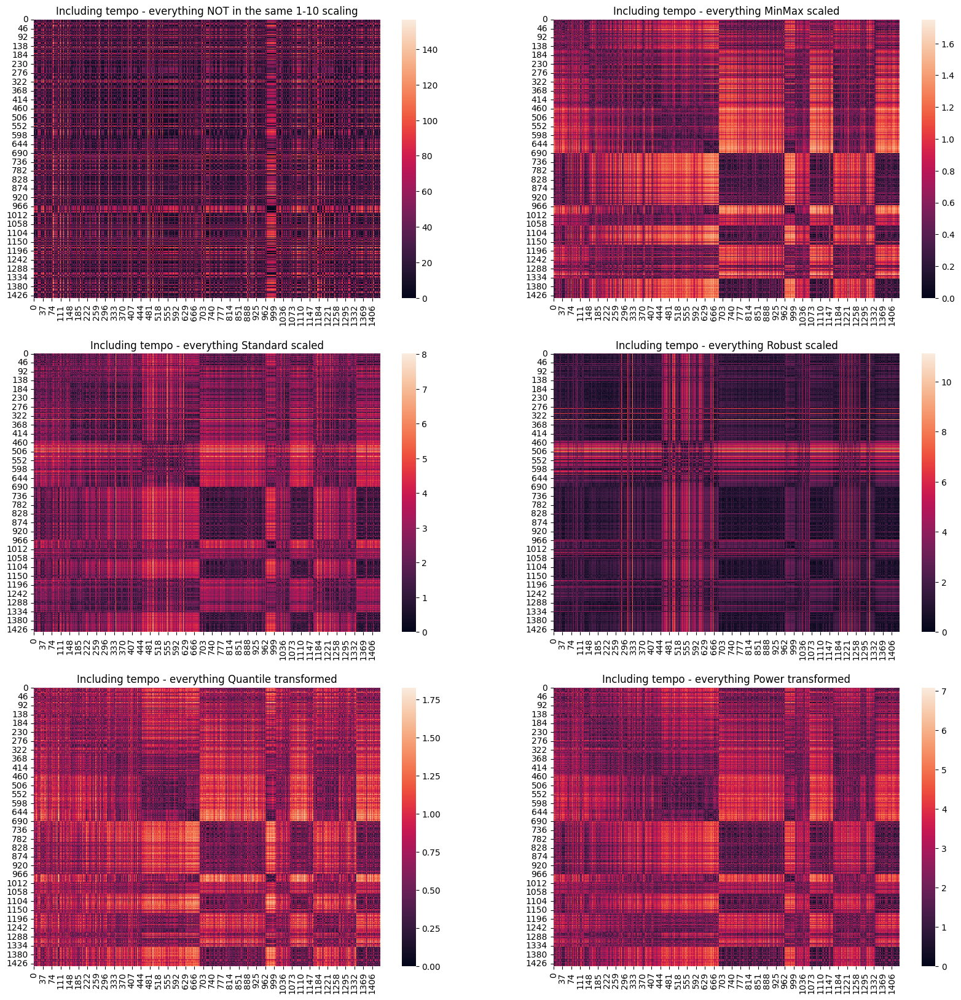

In [104]:
fig, ax = plt.subplots(3, 2, figsize=(20, 20))

sns.heatmap(songs_edis_df, ax=ax[0, 0]);
sns.heatmap(songs_minmax_edis_df, ax=ax[0, 1]);
sns.heatmap(songs_std_edis_df, ax=ax[1, 0]);
sns.heatmap(songs_robust_edis_df, ax=ax[1, 1]);
sns.heatmap(songs_quant_trans_edis_df, ax=ax[2, 0]);
sns.heatmap(songs_power_trans_edis_df, ax=ax[2, 1]);

ax[0, 0].set_title('Including tempo - everything NOT in the same 1-10 scaling')
ax[0, 1].set_title('Including tempo - everything MinMax scaled')
ax[1, 0].set_title('Including tempo - everything Standard scaled')
ax[1, 1].set_title('Including tempo - everything Robust scaled')
ax[2, 0].set_title('Including tempo - everything Quantile transformed')
ax[2, 1].set_title('Including tempo - everything Power transformed')

plt.show()

## Apply k-mean

### For MinMaxScaler

In [ ]:
# 1. import the model
from sklearn.cluster import KMeans
 
# 2. initialize the model
my_kmeans = KMeans(n_clusters= 4)
 
# 3. fit the model to the data
my_kmeans.fit(songs_minmax_df) # pass your scaled data here
 
# 4. obtain the cluster output
clusters = my_kmeans.predict(songs_minmax_df) # pass your scaled data here
 
# 5. attach the cluster output to our original DataFrame
songs_df["cluster"] = clusters